<a href="https://colab.research.google.com/github/NileshCT/Machine_Learning_Models/blob/main/Copy_of_ML_Classification_Modelling_WeatherAUS_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#Importing required libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import plotly.express as px

In [2]:
df=pd.read_csv("/content/drive/MyDrive/weatherAUS.csv.zip")

**Data Understanding**

In [3]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [4]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
145459,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [6]:
df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


In [7]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [8]:
df.nunique()

Date             3436
Location           49
MinTemp           389
MaxTemp           505
Rainfall          681
Evaporation       358
Sunshine          145
WindGustDir        16
WindGustSpeed      67
WindDir9am         16
WindDir3pm         16
WindSpeed9am       43
WindSpeed3pm       44
Humidity9am       101
Humidity3pm       101
Pressure9am       546
Pressure3pm       549
Cloud9am           10
Cloud3pm           10
Temp9am           441
Temp3pm           502
RainToday           2
RainTomorrow        2
dtype: int64

In [9]:
df.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [10]:
df.drop(["Date"],axis=1,inplace=True)

In [11]:
numeric_feature=df.describe(include=float).columns
numeric_feature

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

In [12]:
#Exploring all numeric_features from dataframe.
categorical_feature=df.describe(include=object).columns
categorical_feature

Index(['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday',
       'RainTomorrow'],
      dtype='object')

In [13]:
#Creating new dataframe by cloning df dataframe.
df1=df.copy()

In [14]:
a=[(i,index) for i,index in enumerate(df["RainTomorrow"]) if pd.isna(index)]
result = pd.DataFrame(a).set_index(0)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 22 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Location       145460 non-null  object 
 1   MinTemp        143975 non-null  float64
 2   MaxTemp        144199 non-null  float64
 3   Rainfall       142199 non-null  float64
 4   Evaporation    82670 non-null   float64
 5   Sunshine       75625 non-null   float64
 6   WindGustDir    135134 non-null  object 
 7   WindGustSpeed  135197 non-null  float64
 8   WindDir9am     134894 non-null  object 
 9   WindDir3pm     141232 non-null  object 
 10  WindSpeed9am   143693 non-null  float64
 11  WindSpeed3pm   142398 non-null  float64
 12  Humidity9am    142806 non-null  float64
 13  Humidity3pm    140953 non-null  float64
 14  Pressure9am    130395 non-null  float64
 15  Pressure3pm    130432 non-null  float64
 16  Cloud9am       89572 non-null   float64
 17  Cloud3pm       86102 non-null

**Visualization using plotly library**

**1] Bar plot**

In [16]:
fig = px.histogram(df, x="WindDir9am",text_auto=True)
fig.show()

In [17]:
fig = px.histogram(df, x="WindGustDir",text_auto=True)
fig.show()

In [18]:
fig = px.histogram(df, x="WindGustDir",color="RainToday",text_auto=True)
fig.show()

In [19]:
fig = px.histogram(df, x="WindDir9am",color="RainToday",text_auto=True)
fig.show()

In [20]:
fig = px.histogram(df, x="WindDir3pm",text_auto=True)
fig.show()

In [21]:
fig = px.histogram(df, x="WindDir3pm",color="RainToday",text_auto=True)
fig.show()

In [22]:
fig = px.histogram(df, x="Location",color="WindDir3pm",
             pattern_shape="RainToday", pattern_shape_sequence=["+", "x"])
fig.show()

In [23]:
fig = px.histogram(df,x="Location", y="MinTemp", color="RainToday", title="Weather", pattern_shape="RainTomorrow",template="simple_white",pattern_shape_sequence=["+", "x"])
fig.show()

In [24]:
fig = px.histogram(df, x="Location",color="WindDir9am",
             pattern_shape="RainToday", pattern_shape_sequence=["+", "x"])
fig.show()

In [25]:
fig = px.histogram(df, x="Location",color="RainToday",
             pattern_shape="RainTomorrow", pattern_shape_sequence=["+", "x"])
fig.show()

In [26]:
fig=px.bar(df,x='Location')
fig.show()

In [27]:
fig = px.box(df,x="Location", y="MinTemp", color="RainToday", title="Weather",template="simple_white")
fig.show()

In [28]:
fig = px.box(df,x="MinTemp",color="RainToday",title="MinTemp",template="simple_white")
fig.show()

In [29]:
fig = px.histogram(df,x="Location",color="RainToday", title="Weather",template="simple_white")
fig.show()

In [30]:
fig = px.histogram(df,x="RainToday",title="Weather",template="simple_white")
fig.show()

In [31]:
fig = px.histogram(df, x="Location",
             color='RainToday', barmode='group',
             height=400)
fig.show()

In [32]:
fig = px.histogram(df, x="Location",color="RainTomorrow", text_auto=True)
fig.show()

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 22 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Location       145460 non-null  object 
 1   MinTemp        143975 non-null  float64
 2   MaxTemp        144199 non-null  float64
 3   Rainfall       142199 non-null  float64
 4   Evaporation    82670 non-null   float64
 5   Sunshine       75625 non-null   float64
 6   WindGustDir    135134 non-null  object 
 7   WindGustSpeed  135197 non-null  float64
 8   WindDir9am     134894 non-null  object 
 9   WindDir3pm     141232 non-null  object 
 10  WindSpeed9am   143693 non-null  float64
 11  WindSpeed3pm   142398 non-null  float64
 12  Humidity9am    142806 non-null  float64
 13  Humidity3pm    140953 non-null  float64
 14  Pressure9am    130395 non-null  float64
 15  Pressure3pm    130432 non-null  float64
 16  Cloud9am       89572 non-null   float64
 17  Cloud3pm       86102 non-null

<ipython-input-34-47f0f14bdc72>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



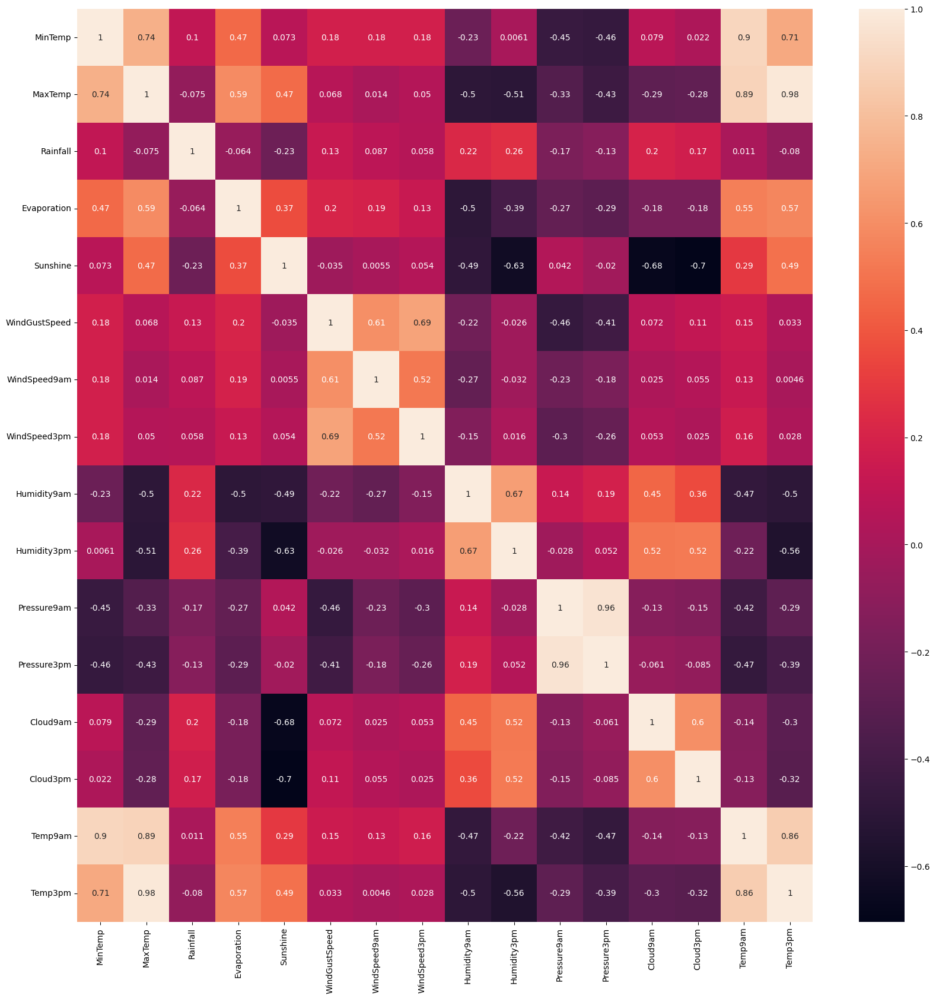

In [34]:
plt.figure(figsize=(20,20))
corr=df.corr()
sns.heatmap(corr,annot=True)
plt.show()

**Extracting inferencial data**

In [35]:
t=pd.DataFrame(a).set_index(0)
t.head()

,1
0,
14,NaN
283,NaN
435,NaN
437,NaN
443,NaN


In [36]:
t.shape

(3267, 1)

In [37]:
index_nan=t.index.tolist()
index_nan

[14,
 283,
 435,
 437,
 443,
 452,
 455,
 464,
 611,
 983,
 984,
 985,
 986,
 1013,
 1374,
 1529,
 1530,
 1531,
 1685,
 1922,
 2031,
 2032,
 2033,
 2042,
 2913,
 2934,
 2942,
 2943,
 2944,
 3201,
 3211,
 3316,
 3338,
 3339,
 3384,
 3411,
 3412,
 3428,
 3433,
 3438,
 3446,
 3447,
 3452,
 3457,
 3462,
 3471,
 3472,
 3482,
 3517,
 3524,
 3525,
 3526,
 3529,
 3530,
 3532,
 3539,
 3542,
 3549,
 3552,
 3576,
 3584,
 3595,
 3629,
 3634,
 3639,
 3692,
 3760,
 3955,
 4044,
 4050,
 4131,
 4344,
 4345,
 4629,
 4644,
 4656,
 4845,
 4900,
 4911,
 4912,
 4935,
 4938,
 4939,
 5056,
 5079,
 5149,
 5393,
 5458,
 5459,
 5460,
 5461,
 5462,
 5841,
 5842,
 5843,
 5844,
 5845,
 5846,
 5847,
 5848,
 5849,
 5850,
 5851,
 5852,
 5853,
 5854,
 5855,
 5856,
 5857,
 5876,
 6294,
 6968,
 6969,
 6970,
 7446,
 7447,
 8529,
 8530,
 8588,
 8838,
 8839,
 8840,
 8841,
 8842,
 8843,
 8847,
 8848,
 8849,
 8904,
 8905,
 8906,
 9147,
 10238,
 10448,
 10534,
 10816,
 10820,
 10821,
 10822,
 10920,
 10921,
 10922,
 10923,
 1

In [38]:
df1_inference=df1.iloc[index_nan]
df1_inference

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
14,Albury,8.4,24.6,0.0,NaN,NaN,NaN,NaN,S,WNW,...,57.0,32.0,1009.7,1008.7,NaN,NaN,15.9,23.5,No,NaN
283,Albury,2.6,NaN,0.0,NaN,NaN,NaN,NaN,E,WNW,...,71.0,55.0,1017.8,1017.6,NaN,6.0,9.7,14.3,No,NaN
435,Albury,22.1,35.1,0.0,NaN,NaN,NaN,NaN,ENE,SW,...,58.0,37.0,1020.9,1017.8,NaN,1.0,26.9,33.5,No,NaN
437,Albury,21.5,35.0,0.0,NaN,NaN,NaN,NaN,SSE,E,...,76.0,35.0,1015.8,1010.3,NaN,8.0,24.2,33.1,No,NaN
443,Albury,15.5,30.6,0.0,NaN,NaN,NaN,NaN,SE,SSW,...,66.0,30.0,1015.9,1013.8,NaN,NaN,19.4,30.0,No,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144955,Uluru,22.5,37.7,0.0,NaN,NaN,SE,50.0,SE,ESE,...,22.0,11.0,1012.6,1009.6,NaN,NaN,28.8,37.2,No,NaN
145091,Uluru,12.3,19.1,0.0,NaN,NaN,NaN,NaN,NaN,NaN,...,79.0,62.0,1016.8,1014.1,8.0,8.0,15.6,18.9,No,NaN
145092,Uluru,14.2,18.7,NaN,NaN,NaN,NaN,NaN,W,NaN,...,81.0,67.0,1015.2,1014.6,8.0,8.0,16.6,17.5,NaN,NaN
145335,Uluru,13.5,NaN,0.0,NaN,NaN,NaN,NaN,ENE,SW,...,23.0,11.0,1013.7,1008.4,NaN,NaN,25.2,34.4,No,NaN


In [39]:
#Creating list of all non null values in the target variable for spliting in train and test data.
a=[]
for i in range(df1.shape[0]):
  if i not in index_nan:
    a.append(i)

**Separating known data**

In [40]:
df_Known_data=df.iloc[a]
df_Known_data

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,E,...,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,No
145455,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No


**Missing values tratment for known data**

In [41]:
df_Known_data=df_Known_data.fillna(method="bfill",axis=0).fillna(method="ffill",axis=0)
df_Known_data

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,12.0,12.3,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,2.0,16.9,21.8,No,No
1,Albury,7.4,25.1,0.0,12.0,12.3,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,7.0,2.0,17.2,24.3,No,No
2,Albury,12.9,25.7,0.0,12.0,12.3,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,7.0,2.0,21.0,23.2,No,No
3,Albury,9.2,28.0,0.0,12.0,12.3,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,7.0,8.0,18.1,26.5,No,No
4,Albury,17.5,32.3,1.0,12.0,12.3,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,Uluru,3.5,21.8,0.0,6.4,10.7,E,31.0,ESE,E,...,59.0,27.0,1024.7,1021.2,3.0,2.0,9.4,20.9,No,No
145455,Uluru,2.8,23.4,0.0,6.4,10.7,E,31.0,SE,ENE,...,51.0,24.0,1024.6,1020.3,3.0,2.0,10.1,22.4,No,No
145456,Uluru,3.6,25.3,0.0,6.4,10.7,NNW,22.0,SE,N,...,56.0,21.0,1023.5,1019.1,3.0,2.0,10.9,24.5,No,No
145457,Uluru,5.4,26.9,0.0,6.4,10.7,N,37.0,SE,WNW,...,53.0,24.0,1021.0,1016.8,3.0,2.0,12.5,26.1,No,No


**known data splitting for further scaling. i am not appling the scaling on the target feature**

In [42]:
x_known=df_Known_data.drop(["RainTomorrow"],axis=1)
y_known=df_Known_data["RainTomorrow"]

**lebal encoding on x_known data**

In [43]:
#Label encoding on known data
from sklearn import preprocessing
L_Encoder=preprocessing.LabelEncoder()
x_known["Location"]=L_Encoder.fit_transform(x_known["Location"])

In [44]:
x_known["Location"].unique()

array([ 2,  4, 10, 11, 21, 24, 26, 27, 30, 34, 37, 38, 42, 45, 47,  9, 40,
       23,  5,  6, 35, 19, 18, 20, 25, 33, 44, 12,  7,  8, 14, 39,  0, 22,
       28, 48,  1, 46, 29, 32, 31, 36, 43, 15, 17,  3, 13, 16, 41])

In [45]:
x_known["WindGustDir"]=L_Encoder.fit_transform(x_known["WindGustDir"])

In [46]:
x_known["WindDir9am"]=L_Encoder.fit_transform(x_known["WindDir9am"])

In [47]:
x_known["WindDir3pm"]=L_Encoder.fit_transform(x_known["WindDir3pm"])

In [48]:
x_known["RainToday"]=L_Encoder.fit_transform(x_known["RainToday"])

In [49]:
x_known.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,2,13.4,22.9,0.6,12.0,12.3,13,44.0,13,14,...,24.0,71.0,22.0,1007.7,1007.1,8.0,2.0,16.9,21.8,0
1,2,7.4,25.1,0.0,12.0,12.3,14,44.0,6,15,...,22.0,44.0,25.0,1010.6,1007.8,7.0,2.0,17.2,24.3,0
2,2,12.9,25.7,0.0,12.0,12.3,15,46.0,13,15,...,26.0,38.0,30.0,1007.6,1008.7,7.0,2.0,21.0,23.2,0
3,2,9.2,28.0,0.0,12.0,12.3,4,24.0,9,0,...,9.0,45.0,16.0,1017.6,1012.8,7.0,8.0,18.1,26.5,0
4,2,17.5,32.3,1.0,12.0,12.3,13,41.0,1,7,...,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0


**scaling on x_known data**

In [50]:
from sklearn.preprocessing import StandardScaler
scalar=StandardScaler()
model=scalar.fit(x_known)
x_known1=model.transform(x_known)
print(x_known1)

[[-1.5270045   0.18911965 -0.0462377  ... -0.00962269  0.00708313
  -0.54029965]
 [-1.5270045  -0.74794986  0.26286199 ...  0.03643231  0.36734324
  -0.54029965]
 [-1.5270045   0.11103052  0.3471619  ...  0.61979554  0.20882879
  -0.54029965]
 ...
 [ 1.21224943 -1.34142722  0.29096196 ... -0.93072252  0.39616405
  -0.54029965]
 [ 1.21224943 -1.06030637  0.51576173 ... -0.6850959   0.62673052
  -0.54029965]
 [ 1.21224943 -0.68547856  0.52981172 ... -0.28595264  0.61232012
  -0.54029965]]


In [51]:
x_known2=pd.DataFrame(x_known1)

In [52]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(x_known2,y_known,random_state=0,test_size=0.20)

In [53]:
# train a logistic regression model on the training set
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='liblinear', random_state=0)


# fit the model
logreg.fit(X_train, y_train)

LogisticRegression(random_state=0, solver='liblinear')

In [54]:
y_pred_train = logreg.predict(X_train)

y_pred_train

array(['No', 'No', 'No', ..., 'No', 'No', 'Yes'], dtype=object)

In [55]:
y_pred_train1=pd.DataFrame(y_pred_train)
y_pred_train1.head()

,0
0,No
1,No
2,No
3,No
4,No


In [56]:
y_train

113462     No
89638      No
138130     No
87898      No
16484     Yes
         ... 
43204      No
100206     No
98494      No
120883     No
44785     Yes
Name: RainTomorrow, Length: 113754, dtype: object

In [57]:
y_train1=pd.DataFrame(y_train)
y_train1.head()

,RainTomorrow
113462,No
89638,No
138130,No
87898,No
16484,Yes


**predict_proba method ok known data**

In [58]:
# probability of getting output as 0 - no rain
logreg.predict_proba(X_train)[:,0]

array([0.92000867, 0.66341033, 0.99521918, ..., 0.9370574 , 0.9920492 ,
       0.44736686])

In [59]:
# probability of getting output as 0 - rain
logreg.predict_proba(X_train)[:,1]

array([0.07999133, 0.33658967, 0.00478082, ..., 0.0629426 , 0.0079508 ,
       0.55263314])

**Calculating accuracy_score of known data**

In [60]:
from sklearn.metrics import accuracy_score
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))

Model accuracy score: 0.8389


**Calculating accuracy_score for known test data**

In [61]:
y_pred_test = logreg.predict(X_test)

y_pred_test

array(['No', 'No', 'No', ..., 'No', 'No', 'Yes'], dtype=object)

In [62]:
from sklearn.metrics import accuracy_score
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test, y_pred_test)))

Model accuracy score: 0.8411


In [63]:
# probability of getting output as 0 - no rain

logreg.predict_proba(X_test)[:,0]

array([0.85379011, 0.90253021, 0.81146   , ..., 0.98044505, 0.7863299 ,
       0.31537024])

In [64]:
# probability of getting output as 1 - no rain

logreg.predict_proba(X_test)[:,1]

array([0.14620989, 0.09746979, 0.18854   , ..., 0.01955495, 0.2136701 ,
       0.68462976])

In [65]:
#Confusion matrix
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred_test)

print('Confusion matrix\n\n', cm)

print('\nTrue Positives(TP) = ', cm[0,0])

print('\nTrue Negatives(TN) = ', cm[1,1])

print('\nFalse Positives(FP) = ', cm[0,1])

print('\nFalse Negatives(FN) = ', cm[1,0])

Confusion matrix

 [[20869  1198]
 [ 3322  3050]]

True Positives(TP) =  20869

True Negatives(TN) =  3050

False Positives(FP) =  1198

False Negatives(FN) =  3322


<Axes: >

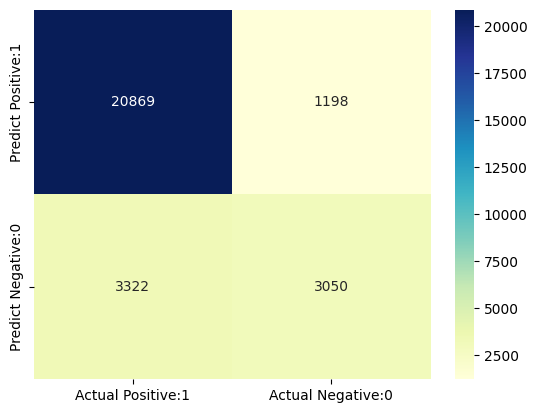

In [66]:
# visualize confusion matrix with seaborn heatmap

cm_matrix = pd.DataFrame(data=cm, columns=['Actual Positive:1', 'Actual Negative:0'], 
                                 index=['Predict Positive:1', 'Predict Negative:0'])

sns.heatmap(cm_matrix, annot=True, fmt='d', cmap='YlGnBu')

In [67]:
#classification report
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

          No       0.86      0.95      0.90     22067
         Yes       0.72      0.48      0.57      6372

    accuracy                           0.84     28439
   macro avg       0.79      0.71      0.74     28439
weighted avg       0.83      0.84      0.83     28439



In [68]:
#accuracy report 
TP = cm[0,0]
TN = cm[1,1]
FP = cm[0,1]
FN = cm[1,0]

In [69]:
# print classification error

classification_error = (FP + FN) / float(TP + TN + FP + FN)

print('Classification error : {0:0.4f}'.format(classification_error))

Classification error : 0.1589


In [70]:
# print precision score

precision = TP / float(TP + FP)


print('Precision : {0:0.4f}'.format(precision))

Precision : 0.9457


In [71]:
recall = TP / float(TP + FN)

print('Recall or Sensitivity : {0:0.4f}'.format(recall))

Recall or Sensitivity : 0.8627


In [72]:
#False positive rate.
false_positive_rate = FP / float(FP + TN)


print('False Positive Rate : {0:0.4f}'.format(false_positive_rate))

False Positive Rate : 0.2820


In [73]:
#specificity
specificity = TN / (TN + FP)

print('Specificity : {0:0.4f}'.format(specificity))

Specificity : 0.7180


In [102]:
# print the first 10 predicted probabilities of two classes- 0 and 1

y_pred_prob = logreg.predict_proba(X_test)[0:10]

y_pred_prob

array([[0.85379011, 0.14620989],
       [0.90253021, 0.09746979],
       [0.81146   , 0.18854   ],
       [0.98497981, 0.01502019],
       [0.90587305, 0.09412695],
       [0.94478108, 0.05521892],
       [0.23830396, 0.76169604],
       [0.25373387, 0.74626613],
       [0.92681953, 0.07318047],
       [0.84837119, 0.15162881]])

In [103]:
# store the probabilities in dataframe

y_pred_prob_df = pd.DataFrame(data=y_pred_prob, columns=['Prob of - No rain tomorrow (0)', 'Prob of - Rain tomorrow (1)'])

y_pred_prob_df

,Prob of - No rain tomorrow (0),Prob of - Rain tomorrow (1)
0,0.853790,0.146210
1,0.902530,0.097470
2,0.811460,0.188540
3,0.984980,0.015020
4,0.905873,0.094127
5,0.944781,0.055219
6,0.238304,0.761696
7,0.253734,0.746266
8,0.926820,0.073180
9,0.848371,0.151629


**Taking inference data for calculating accuracy_score**

In [74]:
df1_inference.head(10)

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
14,Albury,8.4,24.6,0.0,NaN,NaN,NaN,NaN,S,WNW,...,57.0,32.0,1009.7,1008.7,NaN,NaN,15.9,23.5,No,NaN
283,Albury,2.6,NaN,0.0,NaN,NaN,NaN,NaN,E,WNW,...,71.0,55.0,1017.8,1017.6,NaN,6.0,9.7,14.3,No,NaN
435,Albury,22.1,35.1,0.0,NaN,NaN,NaN,NaN,ENE,SW,...,58.0,37.0,1020.9,1017.8,NaN,1.0,26.9,33.5,No,NaN
437,Albury,21.5,35.0,0.0,NaN,NaN,NaN,NaN,SSE,E,...,76.0,35.0,1015.8,1010.3,NaN,8.0,24.2,33.1,No,NaN
443,Albury,15.5,30.6,0.0,NaN,NaN,NaN,NaN,SE,SSW,...,66.0,30.0,1015.9,1013.8,NaN,NaN,19.4,30.0,No,NaN
452,Albury,17.2,NaN,0.0,NaN,NaN,NaN,NaN,NE,E,...,54.0,28.0,1024.6,1020.7,NaN,NaN,20.6,29.2,No,NaN
455,Albury,14.4,NaN,0.0,NaN,NaN,NaN,NaN,SE,SSE,...,50.0,35.0,1018.5,1016.2,6.0,NaN,17.1,25.5,No,NaN
464,Albury,8.8,NaN,0.0,NaN,NaN,NaN,NaN,SSE,SSE,...,69.0,35.0,1023.7,1023.0,NaN,1.0,12.5,21.8,No,NaN
611,Albury,1.2,9.6,0.0,NaN,NaN,NaN,NaN,NaN,N,...,94.0,71.0,1019.8,1017.0,8.0,8.0,5.5,9.2,No,NaN
983,Albury,4.0,NaN,0.2,NaN,NaN,NaN,NaN,W,WSW,...,79.0,47.0,1015.9,1013.8,NaN,NaN,9.3,15.6,No,NaN


**Spliting data of inferenceial data**


In [75]:
x_inference=df1_inference.drop(["RainTomorrow"],axis=1)
y_inference=df1_inference["RainTomorrow"]

In [76]:
x_inference.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3267 entries, 14 to 145459
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Location       3267 non-null   object 
 1   MinTemp        2419 non-null   float64
 2   MaxTemp        2328 non-null   float64
 3   Rainfall       1412 non-null   float64
 4   Evaporation    1320 non-null   float64
 5   Sunshine       1248 non-null   float64
 6   WindGustDir    2271 non-null   object 
 7   WindGustSpeed  2274 non-null   float64
 8   WindDir9am     2714 non-null   object 
 9   WindDir3pm     2817 non-null   object 
 10  WindSpeed9am   2848 non-null   float64
 11  WindSpeed3pm   2835 non-null   float64
 12  Humidity9am    2387 non-null   float64
 13  Humidity3pm    2370 non-null   float64
 14  Pressure9am    2216 non-null   float64
 15  Pressure3pm    2220 non-null   float64
 16  Cloud9am       1036 non-null   float64
 17  Cloud3pm       1003 non-null   float64
 18  Temp9

In [77]:
#Label encoding on known data
from sklearn import preprocessing
L_Encoder=preprocessing.LabelEncoder()
x_inference["Location"]=L_Encoder.fit_transform(x_inference["Location"])

In [78]:
x_inference["Location"].unique()

array([ 2,  4, 10, 11, 20, 23, 25, 26, 29, 31, 34, 35, 39, 42, 44,  9, 37,
       22,  5,  6, 32, 18, 19, 24, 30, 41, 12,  7,  8, 14, 36,  0, 21, 27,
       45,  1, 43, 28, 33, 40, 15, 17,  3, 13, 16, 38])

In [79]:
x_inference["WindGustDir"]=L_Encoder.fit_transform(x_inference["WindGustDir"])

In [80]:
x_inference["WindDir9am"]=L_Encoder.fit_transform(x_inference["WindDir9am"])

In [81]:
x_inference["WindDir3pm"]=L_Encoder.fit_transform(x_inference["WindDir3pm"])

In [82]:
x_inference["RainToday"]=L_Encoder.fit_transform(x_inference["RainToday"])

In [83]:
x_inference.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
14,2,8.4,24.6,0.0,NaN,NaN,16,NaN,8,14,...,30.0,57.0,32.0,1009.7,1008.7,NaN,NaN,15.9,23.5,0
283,2,2.6,NaN,0.0,NaN,NaN,16,NaN,0,14,...,13.0,71.0,55.0,1017.8,1017.6,NaN,6.0,9.7,14.3,0
435,2,22.1,35.1,0.0,NaN,NaN,16,NaN,1,12,...,11.0,58.0,37.0,1020.9,1017.8,NaN,1.0,26.9,33.5,0
437,2,21.5,35.0,0.0,NaN,NaN,16,NaN,10,0,...,7.0,76.0,35.0,1015.8,1010.3,NaN,8.0,24.2,33.1,0
443,2,15.5,30.6,0.0,NaN,NaN,16,NaN,9,11,...,11.0,66.0,30.0,1015.9,1013.8,NaN,NaN,19.4,30.0,0


**Missing value treatment of inference data**

In [84]:
x_inference=x_inference.fillna(method="bfill",axis=0).fillna(method="ffill",axis=0)

**Scaling on inferencial data**

In [85]:
from sklearn.preprocessing import StandardScaler
scalar=StandardScaler()
model=scalar.fit(x_inference)
x_inference1=model.transform(x_inference)
print(x_inference1)

[[-1.83604947 -0.37644162  0.42089382 ...  0.06989278  0.49797963
  -1.41568169]
 [-1.83604947 -1.22707146  1.92729804 ... -0.84064631 -0.86315775
  -1.41568169]
 [-1.83604947  1.63280473  1.92729804 ...  1.68536535  1.97747677
  -1.41568169]
 ...
 [ 1.05504262  0.47418823 -0.42556188 ...  0.17269558 -0.38971866
   0.82133504]
 [ 1.05504262  0.371526   -0.42556188 ...  1.43570141  2.11063152
  -1.41568169]
 [ 1.05504262  0.57685045 -0.42556188 ... -0.06228225  0.11331037
  -1.41568169]]


In [86]:
type(x_inference1)

numpy.ndarray

In [87]:
x_inference2=pd.DataFrame(x_inference1)

In [88]:
x_inference2

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,-1.836049,-0.376442,0.420894,-0.37223,0.232543,-1.852555,1.041038,-0.911285,-0.223650,0.968545,...,1.174040,-0.967107,-1.004002,-1.233469,-1.088440,0.415128,0.564497,0.069893,0.497980,-1.415682
1,-1.836049,-1.227071,1.927298,-0.37223,0.232543,-1.852555,1.041038,-0.911285,-1.758660,0.968545,...,-0.668638,-0.153482,0.080009,-0.096915,0.220424,0.415128,0.564497,-0.840646,-0.863158,-1.415682
2,-1.836049,1.632805,1.927298,-0.37223,0.232543,-1.852555,1.041038,-0.911285,-1.566784,0.563782,...,-0.885424,-0.908991,-0.768348,0.338062,0.249837,0.415128,-1.376370,1.685365,1.977477,-1.415682
3,-1.836049,1.544809,1.912951,-0.37223,0.232543,-1.852555,1.041038,-0.911285,0.160102,-1.864798,...,-1.318995,0.137098,-0.862610,-0.377546,-0.853138,0.415128,1.340844,1.288840,1.918297,-1.415682
4,-1.836049,0.664847,1.281696,-0.37223,0.232543,-1.852555,1.041038,-0.911285,-0.031774,0.361400,...,-0.885424,-0.444062,-1.098264,-0.363514,-0.338417,0.415128,-1.376370,0.583907,1.459653,-1.415682
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3262,1.055043,1.691469,2.300312,-0.37223,1.022158,0.301435,-0.286912,0.448463,-0.031774,-1.460034,...,0.740469,-3.001169,-1.993752,-0.826555,-0.956083,1.090874,1.340844,1.964402,2.524891,-1.415682
3263,1.055043,0.195534,-0.368175,-0.37223,1.022158,0.301435,1.041038,0.448463,1.311360,1.373308,...,-1.318995,0.311447,0.409925,-0.237230,-0.294298,1.090874,1.340844,0.025834,-0.182589,-1.415682
3264,1.055043,0.474188,-0.425562,-0.37223,1.022158,0.301435,1.041038,0.448463,0.735731,1.373308,...,-1.318995,0.427679,0.645580,-0.461735,-0.220766,1.090874,1.340844,0.172696,-0.389719,0.821335
3265,1.055043,0.371526,-0.425562,-0.37223,1.022158,0.301435,1.041038,0.448463,-1.566784,0.563782,...,-1.318995,-2.943053,-1.993752,-0.672208,-1.132558,1.090874,1.340844,1.435701,2.110632,-1.415682


In [89]:
x_inference2=pd.DataFrame(x_inference1)

In [90]:
from sklearn.model_selection import train_test_split
X_train1,X_test1,y_train1,y_test1=train_test_split(x_inference2,y_inference,random_state=0,test_size=0.20)

In [91]:
# train a logistic regression model on the training set
from sklearn.linear_model import LogisticRegression


# instantiate the model
logreg = LogisticRegression(solver='liblinear', random_state=0)


#fit the model
logreg.fit(X_train,y_train)

LogisticRegression(random_state=0, solver='liblinear')

In [92]:
# y_pred_test1 = logreg.predict(X_test1)

# len(y_pred_test1)

In [93]:
y_pred_train2=pd.DataFrame(y_pred_train1)
y_pred_train2

,0
0,No
1,No
2,No
3,No
4,No
...,...
113749,No
113750,No
113751,No
113752,No


In [94]:
y_pred_test1 = logreg.predict(X_test1)

y_pred_test1

array(['No', 'No', 'No', 'No', 'No', 'No', 'No', 'Yes', 'No', 'No', 'No',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No',
       'No', 'No', 'Yes', 'No', 'No', 'Yes', 'No', 'No', 'No', 'No', 'No',
       'No', 'Yes', 'No', 'No', 'Yes', 'No', 'Yes', 'No', 'No', 'No',
       'Yes', 'No', 'No', 'No', 'Yes', 'No', 'No', 'Yes', 'No', 'Yes',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No',
       'No', 'No', 'No', 'No', 'No', 'No', 'Yes', 'Yes', 'No', 'Yes',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'Yes', 'No', 'No',
       'No', 'No', 'Yes', 'No', 'No', 'Yes', 'Yes', 'Yes', 'No', 'No',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No',
       'No', 'No', 'Yes', 'No', 'No', 'No', 'No', 'No', 'Yes', 'Yes',
       'No', 'No', 'No', 'Yes', 'No', 'No', 'No', 'No', 'No', 'No', 'No',
       'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No', 'No'

In [95]:
y_pred_test2=pd.DataFrame(y_pred_test1)
# y_pred_test2
y_pred_test2

,0
0,No
1,No
2,No
3,No
4,No
...,...
649,No
650,No
651,No
652,No


**# probability of getting output as 0 - no rain**

In [96]:
# probability of getting output as 0 - no rain

logreg.predict_proba(X_train1)[:,0]

array([0.79494582, 0.93464019, 0.92323421, ..., 0.96324642, 0.73623497,
       0.96740047])

In [97]:
logreg.predict_proba(X_train1)[:,1]

array([0.20505418, 0.06535981, 0.07676579, ..., 0.03675358, 0.26376503,
       0.03259953])

**proba of test_inference data**

In [98]:
# probability of getting output as 0 - no rain

logreg.predict_proba(X_test1)[:,0]

array([0.75095553, 0.96271312, 0.72514482, 0.85898183, 0.91063476,
       0.87508725, 0.94915738, 0.1478089 , 0.63481983, 0.98282731,
       0.70497032, 0.82073035, 0.85995755, 0.78684356, 0.52816342,
       0.85526834, 0.94891674, 0.92399821, 0.59823759, 0.65260828,
       0.97682557, 0.9674622 , 0.96811143, 0.96359102, 0.0929378 ,
       0.86699976, 0.81121728, 0.09269823, 0.87223906, 0.94882629,
       0.98566536, 0.9524861 , 0.94499283, 0.87069018, 0.39853768,
       0.56146503, 0.62175049, 0.44690945, 0.56594656, 0.43075234,
       0.91984616, 0.84018599, 0.95750888, 0.45879221, 0.94278717,
       0.97669926, 0.92572633, 0.13296697, 0.80851313, 0.9531593 ,
       0.49092472, 0.92663132, 0.49092472, 0.68410983, 0.75419837,
       0.9675661 , 0.56852866, 0.95633797, 0.98680386, 0.61982581,
       0.71755614, 0.94425803, 0.85578919, 0.944436  , 0.75141882,
       0.91968092, 0.96781185, 0.85606053, 0.92563538, 0.98605156,
       0.46199181, 0.37989781, 0.95998342, 0.40286626, 0.98461

In [99]:
logreg.predict_proba(X_test1)[:,1]

array([0.24904447, 0.03728688, 0.27485518, 0.14101817, 0.08936524,
       0.12491275, 0.05084262, 0.8521911 , 0.36518017, 0.01717269,
       0.29502968, 0.17926965, 0.14004245, 0.21315644, 0.47183658,
       0.14473166, 0.05108326, 0.07600179, 0.40176241, 0.34739172,
       0.02317443, 0.0325378 , 0.03188857, 0.03640898, 0.9070622 ,
       0.13300024, 0.18878272, 0.90730177, 0.12776094, 0.05117371,
       0.01433464, 0.0475139 , 0.05500717, 0.12930982, 0.60146232,
       0.43853497, 0.37824951, 0.55309055, 0.43405344, 0.56924766,
       0.08015384, 0.15981401, 0.04249112, 0.54120779, 0.05721283,
       0.02330074, 0.07427367, 0.86703303, 0.19148687, 0.0468407 ,
       0.50907528, 0.07336868, 0.50907528, 0.31589017, 0.24580163,
       0.0324339 , 0.43147134, 0.04366203, 0.01319614, 0.38017419,
       0.28244386, 0.05574197, 0.14421081, 0.055564  , 0.24858118,
       0.08031908, 0.03218815, 0.14393947, 0.07436462, 0.01394844,
       0.53800819, 0.62010219, 0.04001658, 0.59713374, 0.01538

In [100]:
# from sklearn.metrics import accuracy_score
# print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test1, y_pred_test1)))

In [101]:
# from sklearn.metrics import accuracy_score
# print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_train1, y_pred_train1)))